<a href="https://colab.research.google.com/github/NirajBagh/Spectrogram-of-normal-and-bearing-faults/blob/main/spectrogram_calculation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset

This notebook shows the study of the CWRU Bearing Dataset, which contains data of normal and fault bearings. Artificial defects of different diameters (0.007 ~ 0.028 Inches) are manufactured at different locations of the bearings: inner raceway(IR), outer raceway(OR) and ball(B) defects.

Vibration data was recorded for motor loads of 0 to 3 hp (motor speed of 1797 to 1720 RPM) using accelerometers at the drive end (DE) and fan end (FE) and the data is stored as Matlab files. The sampling rate is 12 kHz and each Matlab file contains between ~120k to ~240k sample points. For more information please refer to the website.
The input is the vibration signal data at DE and the output is the type of defects:

1. 0 : Normal (N),
2. 1 : Fault at Ball (B),
3. 2 : Fault at Inner Raceway (IR),
4. 3 : Fault at Outer Raceway (OR),

# Import Libraries

In [ ]:
pip install libfmp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 10.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 21.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.0/110.0 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 2.8 MB/s eta 0:00:00


In [2]:
pip install PyWavelets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 54.1 MB/s eta 0:00:00


In [3]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram
import pandas as pd
import os
import glob
from scipy.signal import butter, filtfilt, hilbert, cwt
from scipy.fft import rfft, rfftfreq
from scipy import signal
import pywt
from skimage.transform import resize
import librosa, librosa.display
import libfmp.c2

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
# Pramaeter settings
col_list= [7]
fs=51200 # sampling rate
class_names= ['Normal', 'imbalance', 'vertical misaligment', 'ball_fault', 'cage_fault', 'outer_race']
sample_len= 51200
seg_len= 256        # Segment length (length of the spectrogram frames), in points
noverlap= 0         # Overlap length (length of the overlap of the specteogram frames), in points


# Dataset

In [6]:
# path
cur_path = "/content/drive/MyDrive/Mafaulda dataset/mafaulda"
Normal_file_names = glob.glob(cur_path+'/normal/*.csv')
print(f'{len(Normal_file_names)} files in the Normal class.')

imbalance_file_names = glob.glob(cur_path+'/imbalance/35g/*.csv')
print(f'{len(imbalance_file_names)} files in imbalance class.')

Parallel_misaligment_file_names = glob.glob(cur_path+'/vertical-misalignment/1.90mm/*.csv')
print(f'{len(Parallel_misaligment_file_names)} files in vertical misaligment class.')

ball_fault_file_names = glob.glob(cur_path+'/overhang/ball_fault/35g/*.csv')
print(f'{len(ball_fault_file_names)} files in ball_fault class.')

cage_fault_file_names = glob.glob(cur_path+'/overhang/cage_fault/35g/*.csv')
print(f'{len(cage_fault_file_names)} files in cage_fault class.')

outer_race_file_names = glob.glob(cur_path+'/overhang/outer_race/35g/*.csv')
print(f'{len(outer_race_file_names)} files in outer_race class.')


10 files in the Normal class.
7 files in imbalance class.
7 files in vertical misaligment class.
8 files in ball_fault class.
9 files in cage_fault class.
7 files in outer_race class.


In [7]:
# Read data
def read_data(file_path, col_list=2):
    data =[]
    for i in file_path:
        f = pd.read_csv(i,usecols = col_list)
        data.append(f)
    return data

Normal_data = read_data(Normal_file_names, col_list)
print(f'Shape of the Normal data is {np.shape(Normal_data)}.')


imbalance_data = read_data(imbalance_file_names, col_list)
print(f'Shape of the imbalance data is {np.shape(imbalance_data)}.')

Parallel_misaligment_data = read_data(Parallel_misaligment_file_names, col_list)
print(f'Shape of the vertical_misaligment data is {np.shape(Parallel_misaligment_data)}.')

ball_fault_data = read_data(ball_fault_file_names, col_list)
print(f'Shape of the ball_fault data is {np.shape(ball_fault_data)}.')

cage_fault_data = read_data(cage_fault_file_names, col_list)
print(f'Shape of the cage_fault data is {np.shape(cage_fault_data)}.')

outer_race_data = read_data(outer_race_file_names, col_list)
print(f'Shape of the outer_race data is {np.shape(outer_race_data)}.')


Shape of the Normal data is (10, 249999, 1).
Shape of the imbalance data is (7, 249999, 1).
Shape of the vertical_misaligment data is (7, 249999, 1).
Shape of the ball_fault data is (8, 249999, 1).
Shape of the cage_fault data is (9, 249999, 1).
Shape of the outer_race data is (7, 249999, 1).


# Plot CWRU Dataset

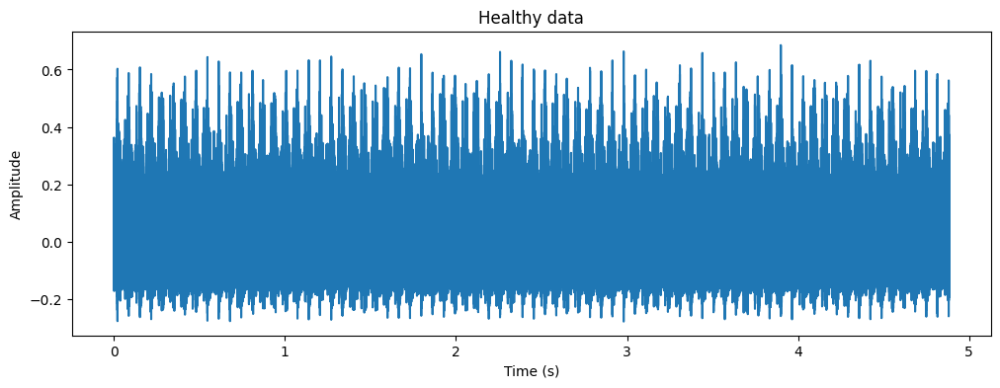

In [8]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
# Select a single segment to plot (for example, the first segment)
Normal_data1 = np.array(Normal_data)
segment1 =Normal_data1[1, :, 0]  # Shape becomes (249999,)

# Sampling frequency
fs = 51200  # Hz
t = np.arange(len(segment1)) / fs  # Time axis in seconds

# Plot
plt.figure(figsize=(12, 4))
plt.plot(t, segment1)
plt.title("Healthy data")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()


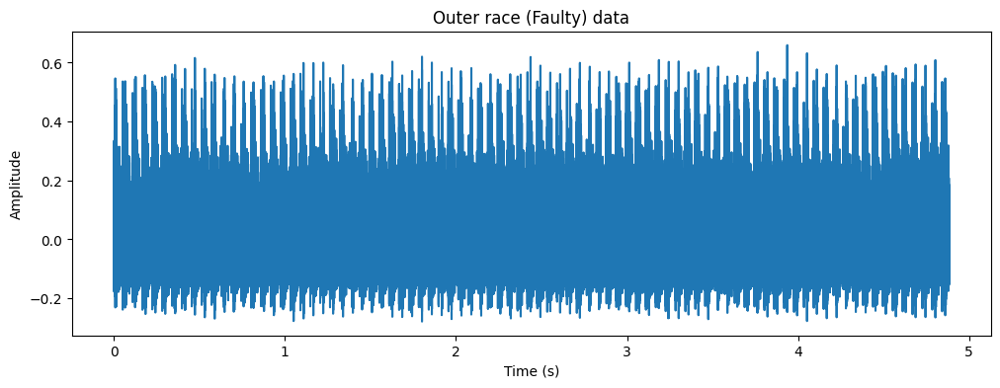

In [9]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
# Select a single segment to plot (for example, the first segment)
outer_race_data1 = np.array(outer_race_data)
segment2 =outer_race_data1[1, :, 0]  # Shape becomes (249999,)

# Sampling frequency
fs = 51200  # Hz
t = np.arange(len(segment2)) / fs  # Time axis in seconds

# Plot
plt.figure(figsize=(12, 4))
plt.plot(t, segment2)
plt.title("Outer race (Faulty) data")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()


# Spectrogram of normal and bearing faults dataset

 The data flow we have to achieve is pretty simple, as we only need to do the following steps:

1. Pick out a short segment of data from the overall signal
2. Multiply that segment against a half-cosine function
3. Pad the end of the segment with zeros
4. Take the Fourier transform of that segment and normalize it into  positive and negative frequencies
5. Combine the energy from the positive and negative frequencies together, and display the one-sided spectrum
6. Scale the resulting spectrum into dB for easier viewing
7. Clip the signal to remove noise past the noise floor which we don’t care about

In [10]:
def stft_on_1s_window(sig, w_len, sr=12000, overlapFac=0.25):

    N = w_len
    HopSize = int(np.floor(overlapFac * N))
    Fs = 12000

    if sig.ndim == 1:
       # print(f"signal has one dimension {sig.shape}")
       X, T_coef, F_coef = libfmp.c2.stft_convention_fmp(sig, Fs, w_len, HopSize)
       Y = np.abs(X) ** 2
       Y = np.array(Y)

    return Y, T_coef, F_coef

# for now Ignor this Normalization function
def min_max_norm(ary):
    ary = (ary - ary.min()) / np.abs(ary.max() - ary.min())
    return ary

# Case-1: Healthy case

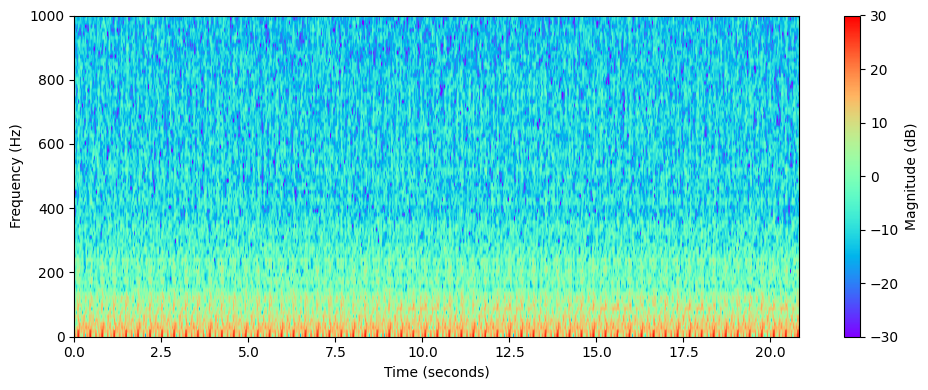

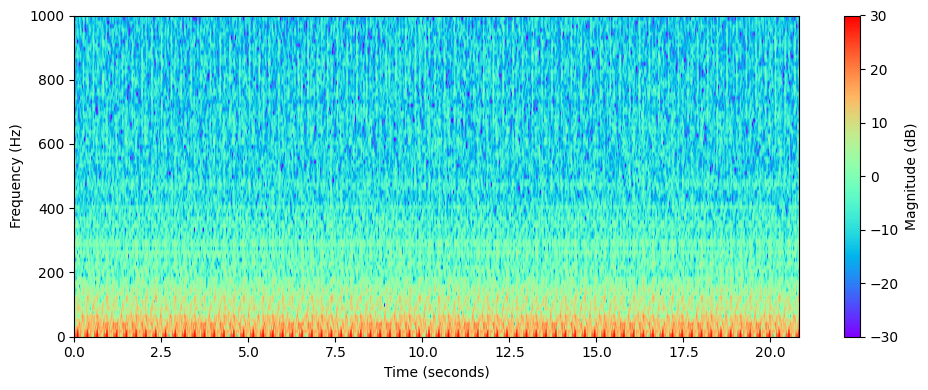

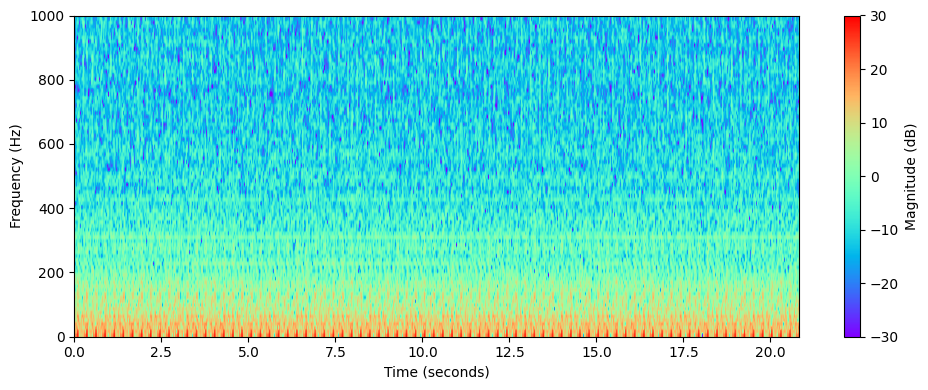

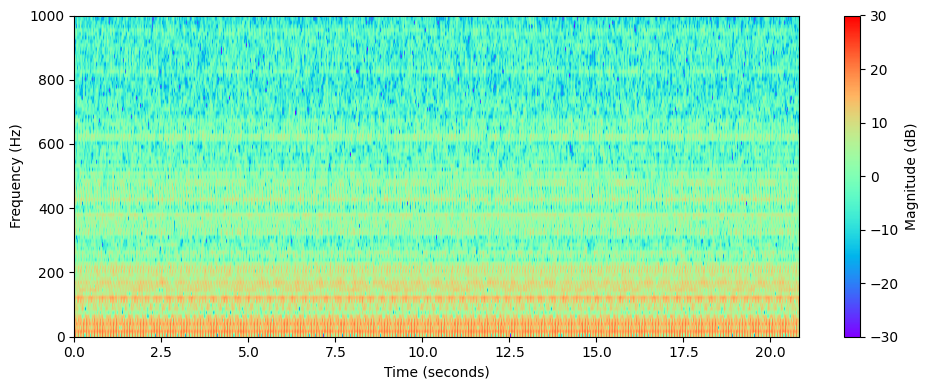

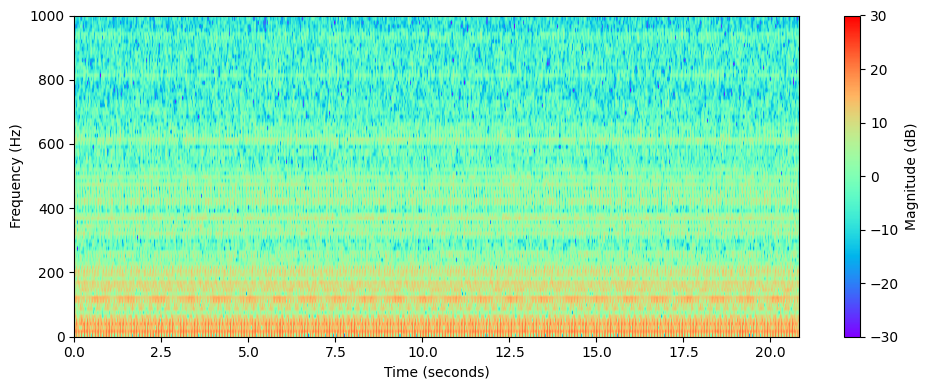

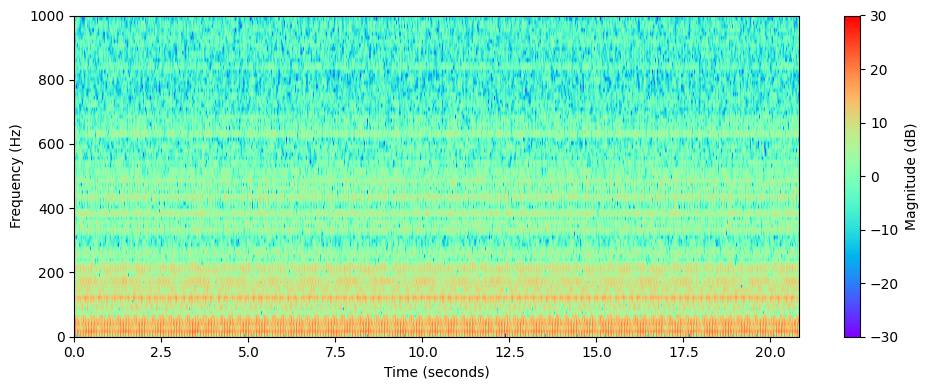

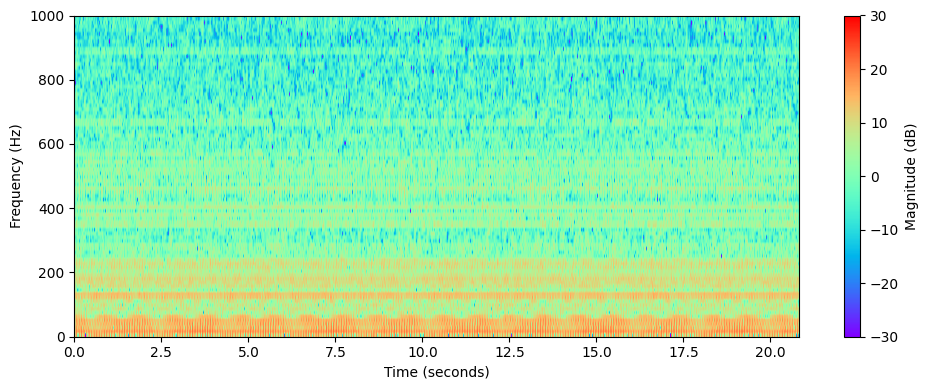

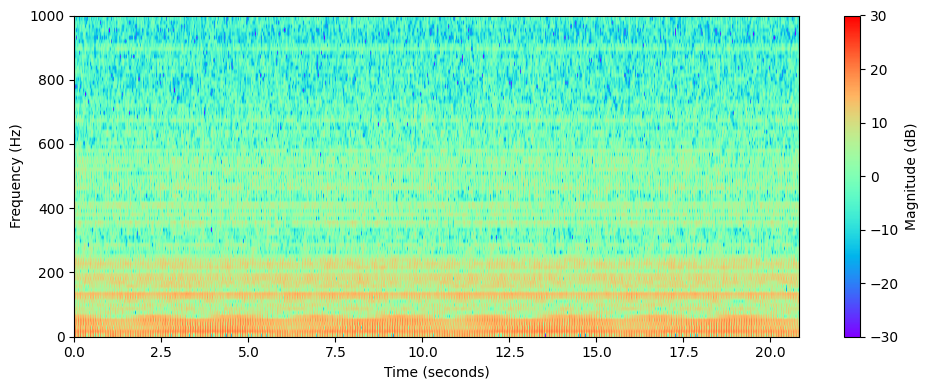

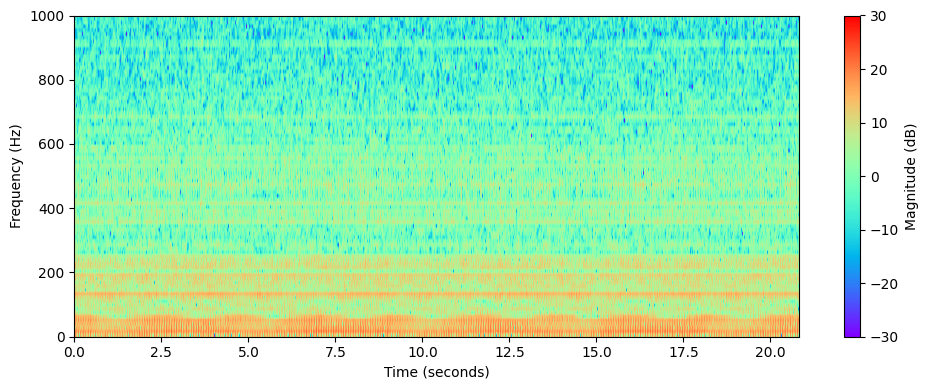

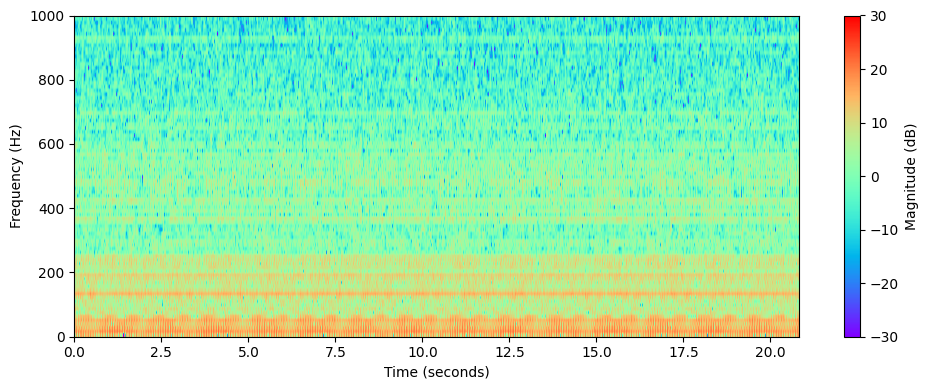

In [11]:
list_of_data_types = Normal_data
for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types

# Case-2: Imbalance case

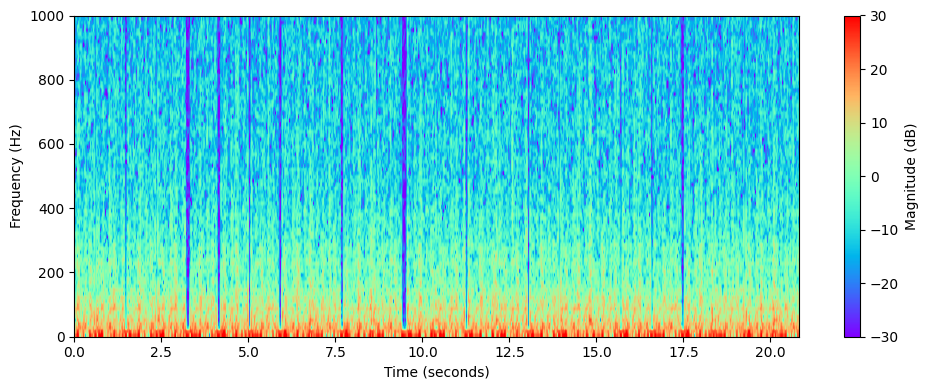

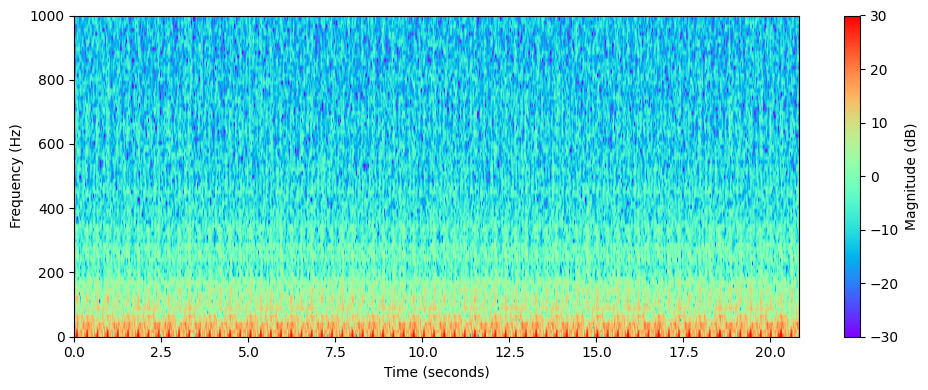

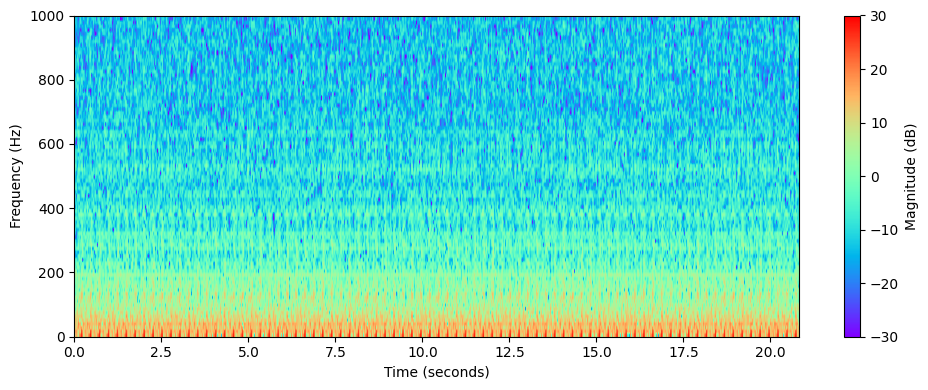

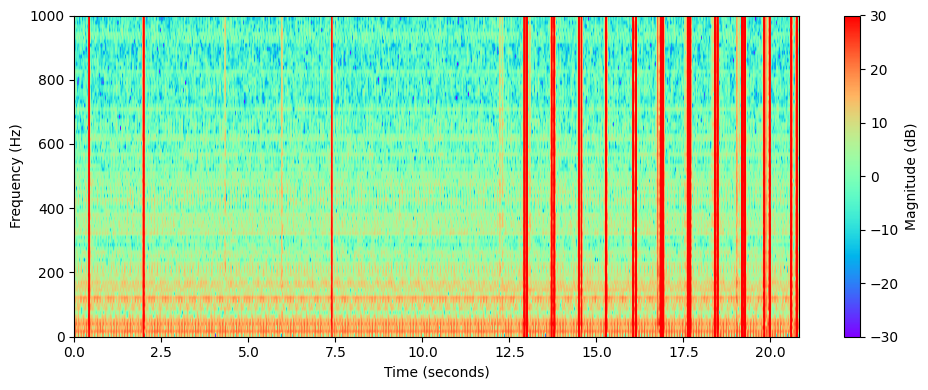

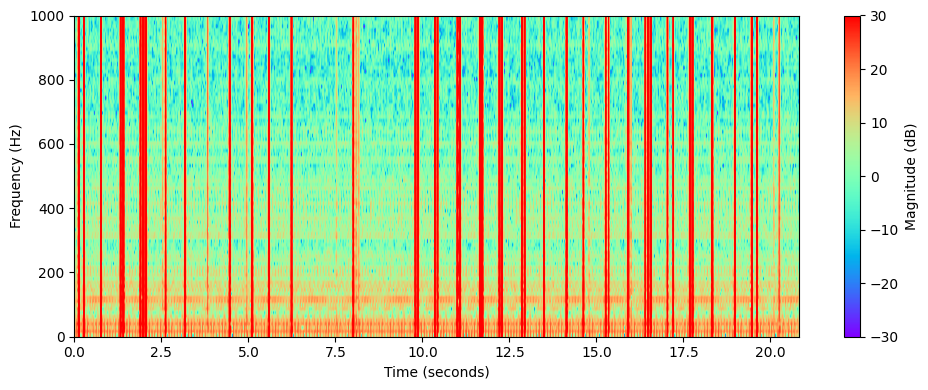

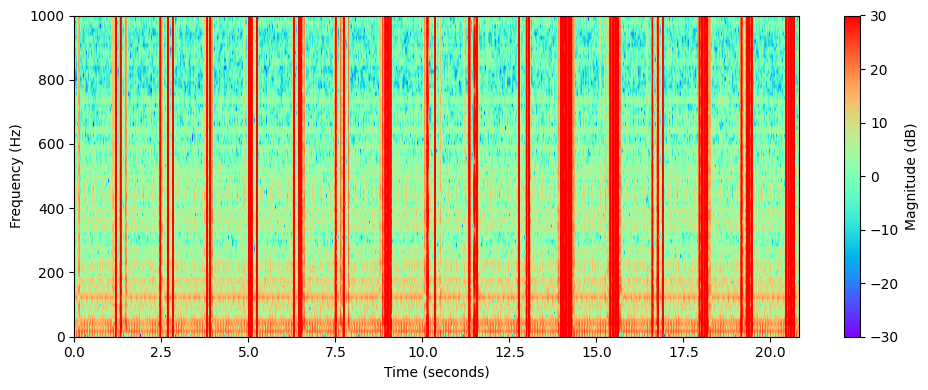

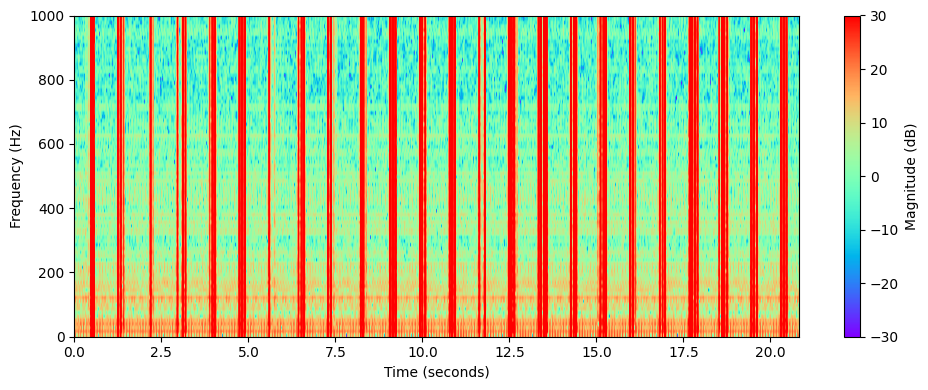

In [12]:
list_of_data_types = imbalance_data

for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types

# Case-3: Misaligment case

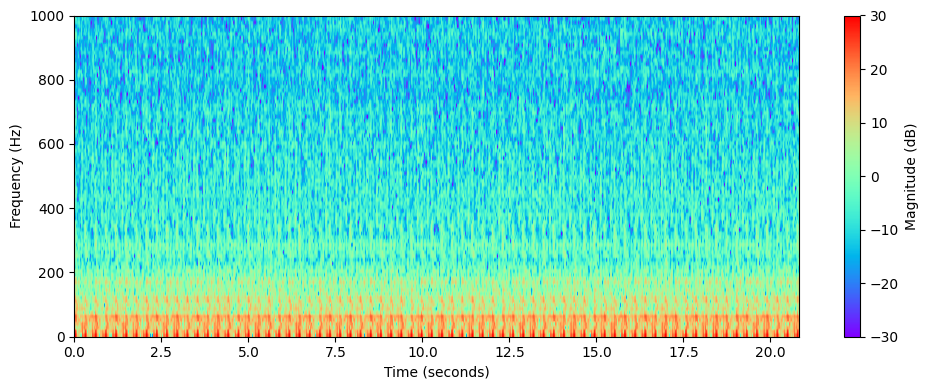

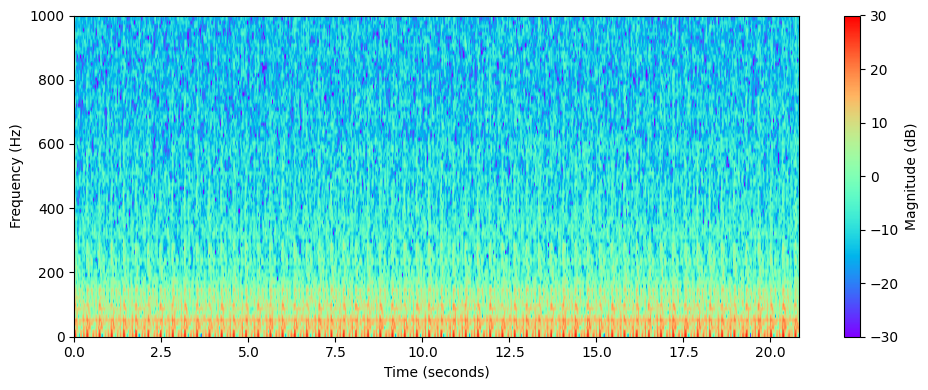

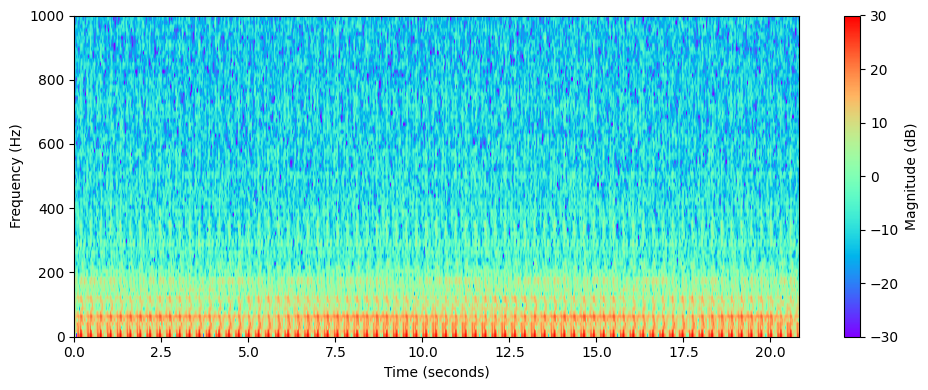

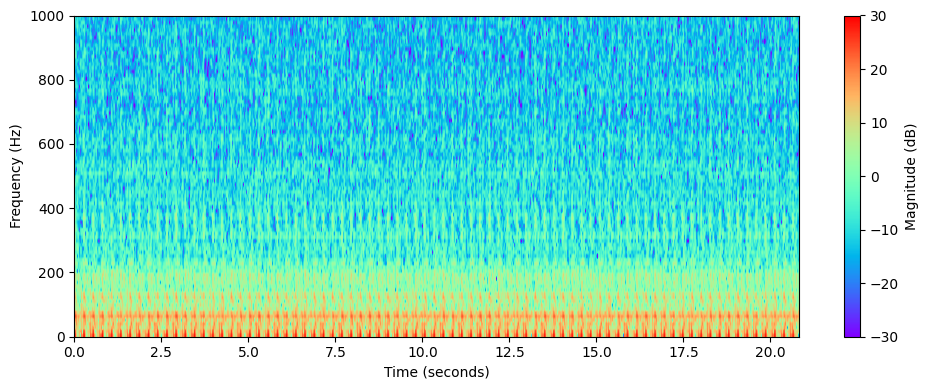

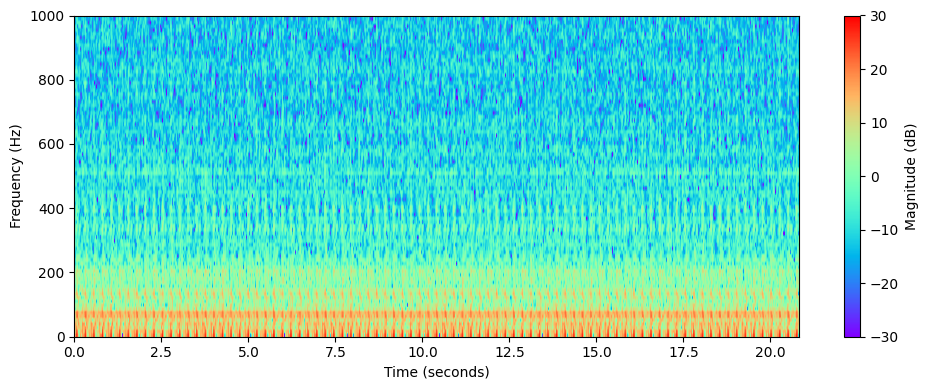

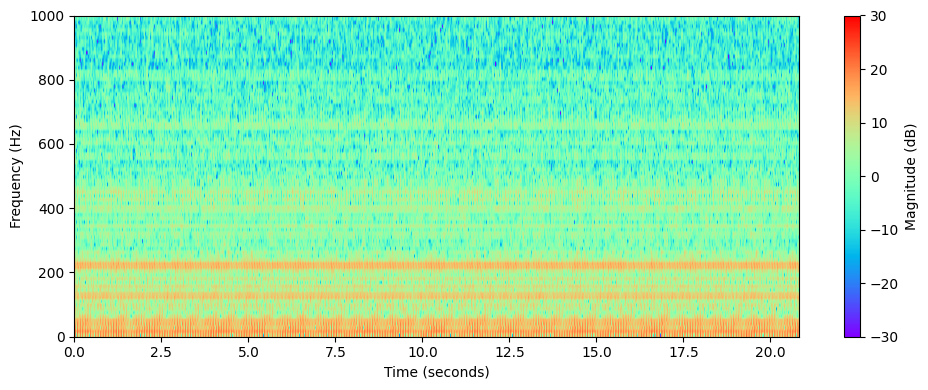

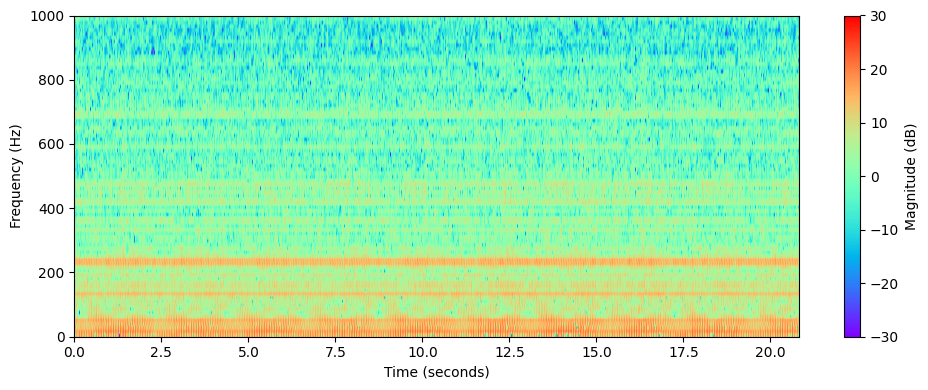

In [13]:
list_of_data_types = Parallel_misaligment_data

for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types

# Case-4: Ball fault case

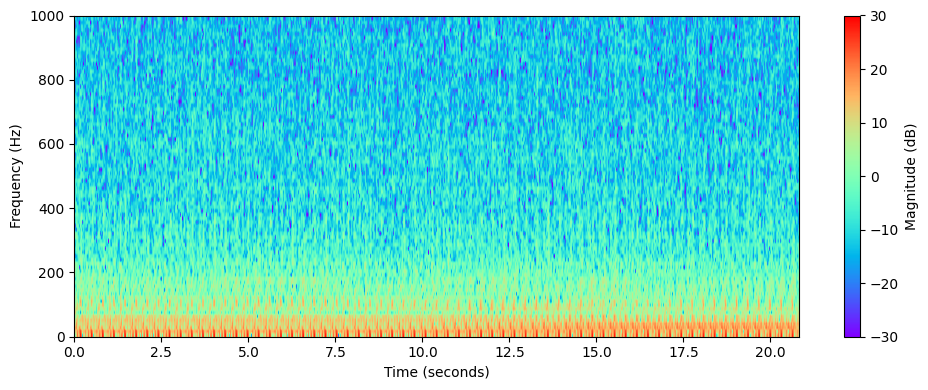

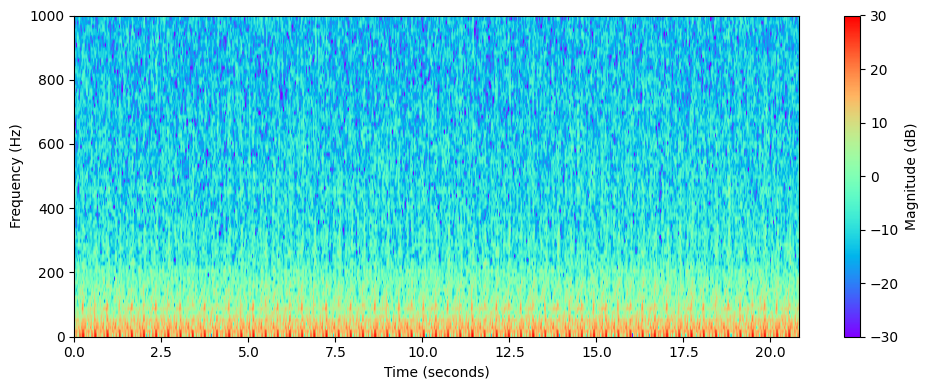

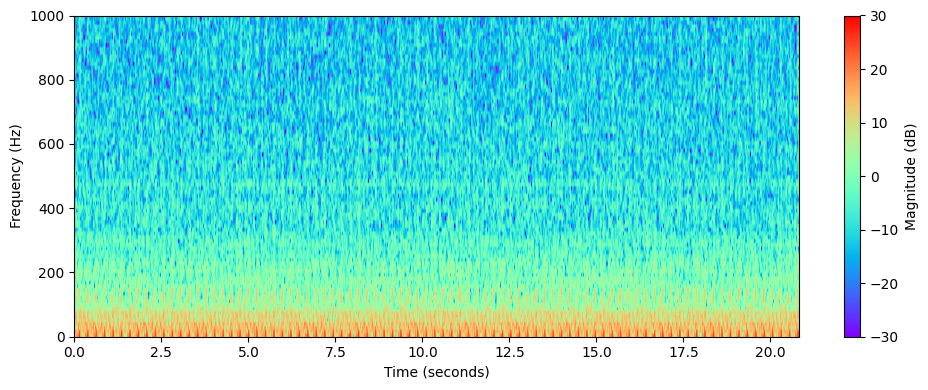

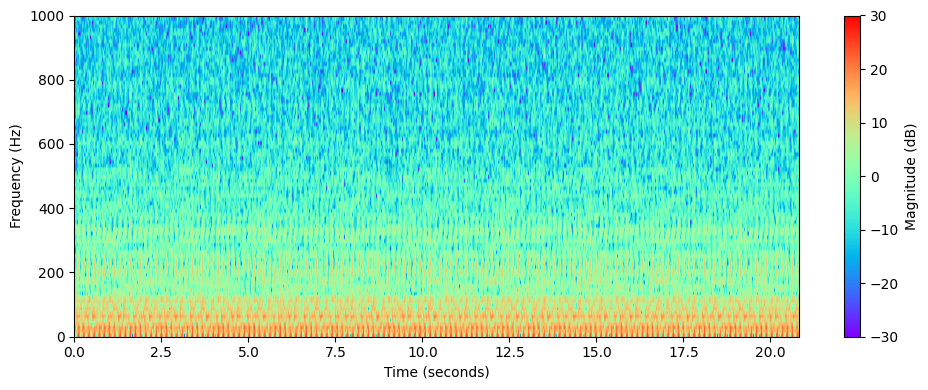

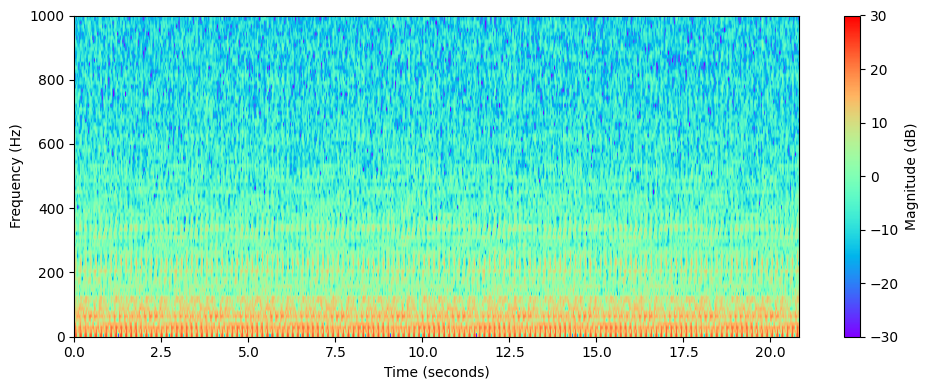

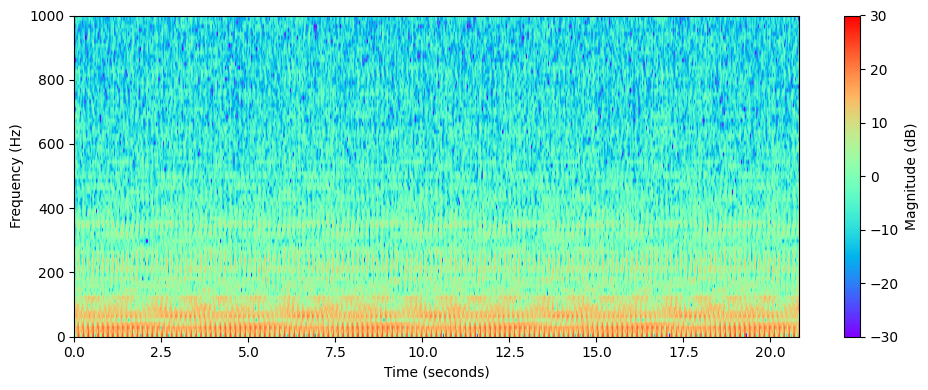

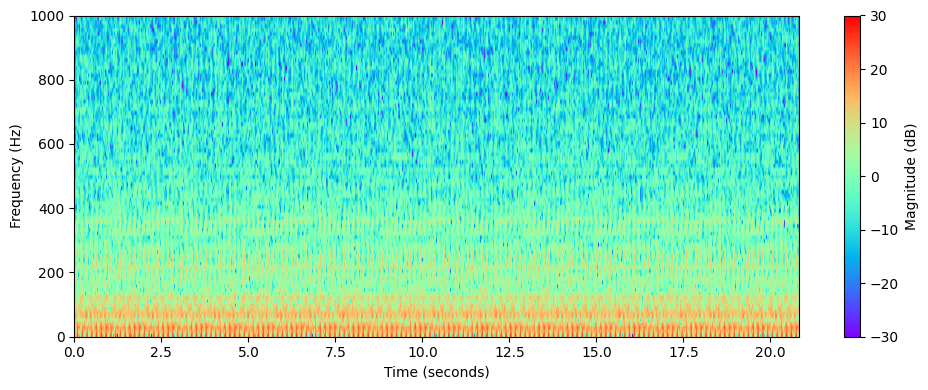

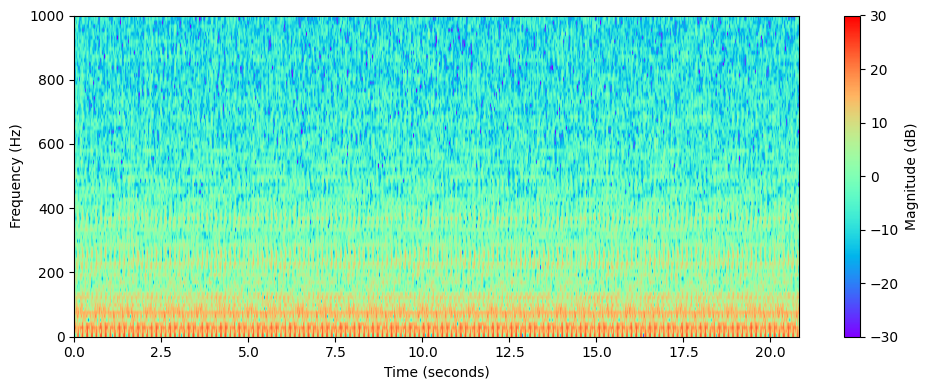

In [14]:
list_of_data_types = ball_fault_data

for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types

# Case-5: Cage fault case


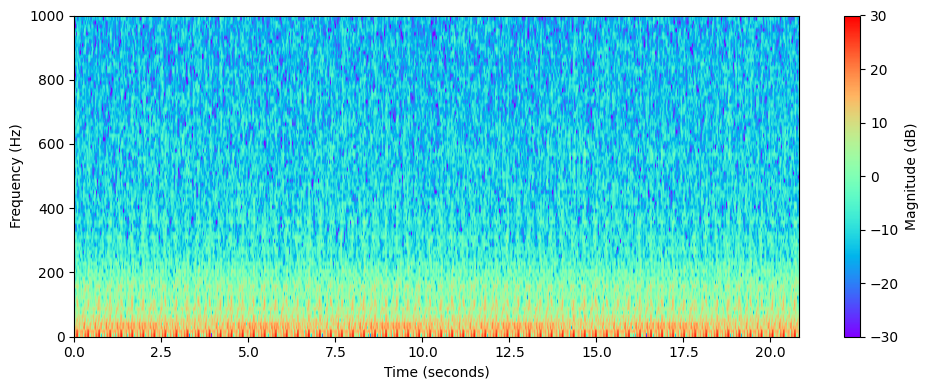

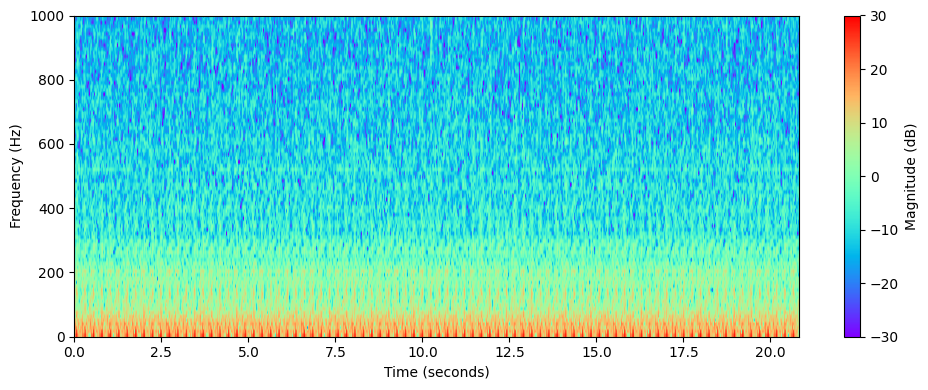

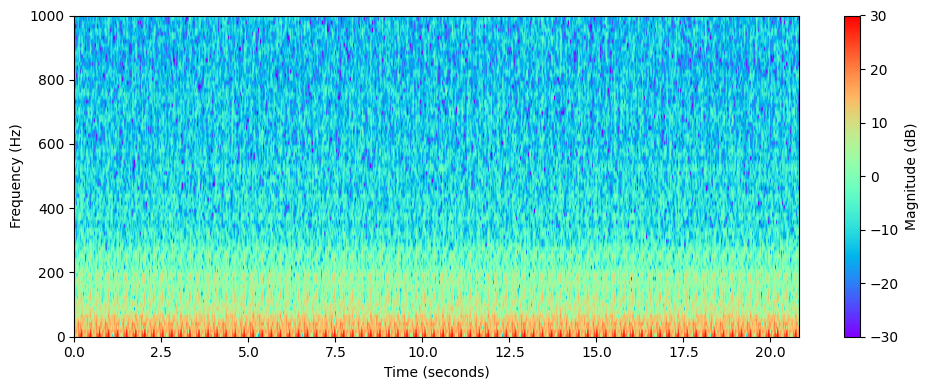

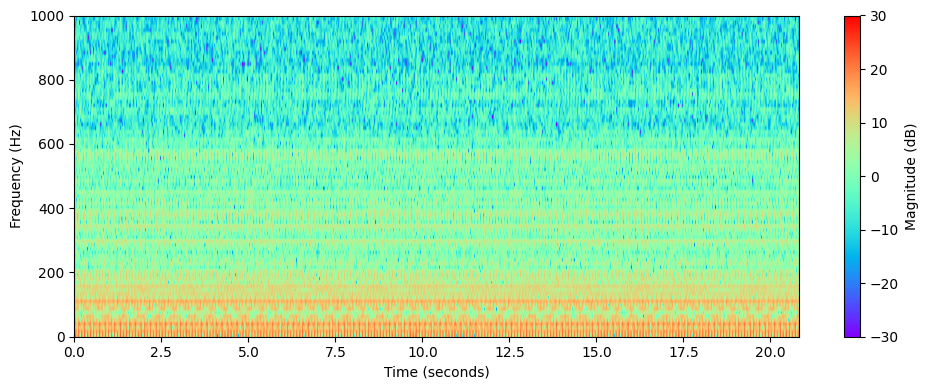

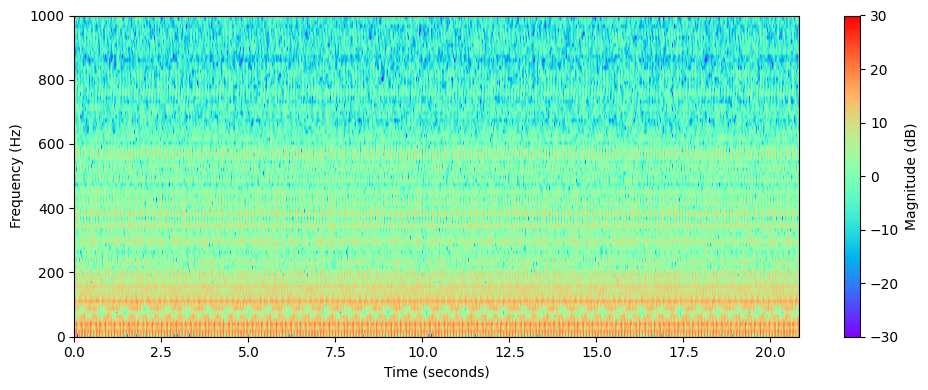

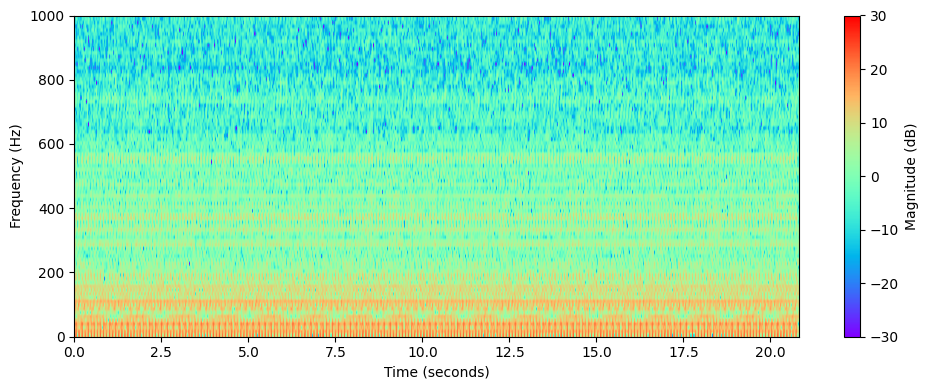

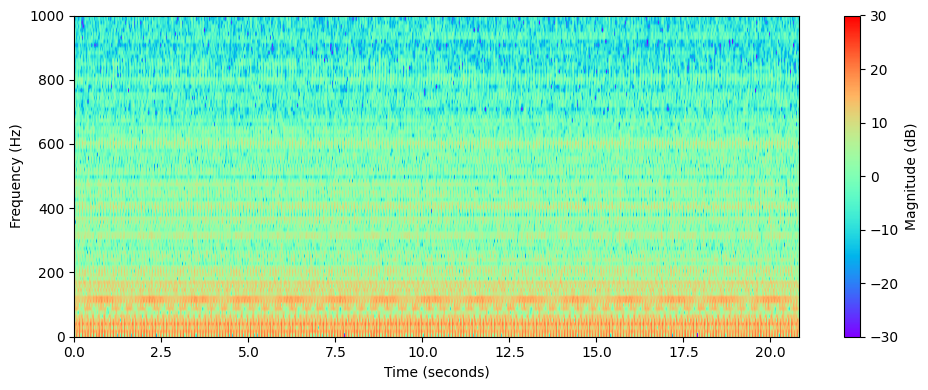

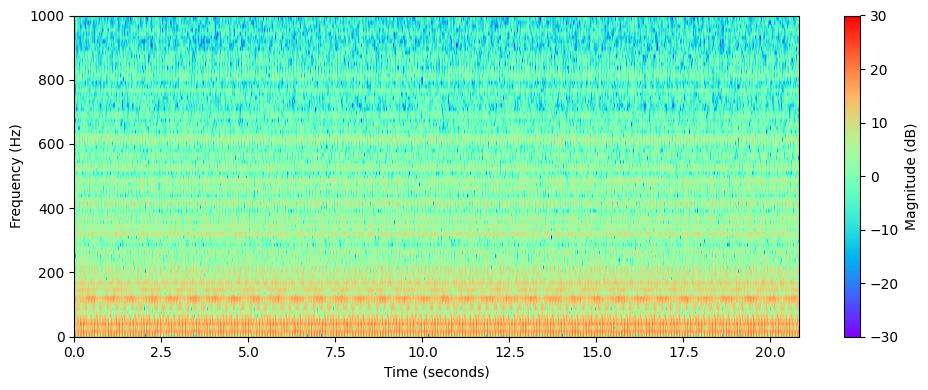

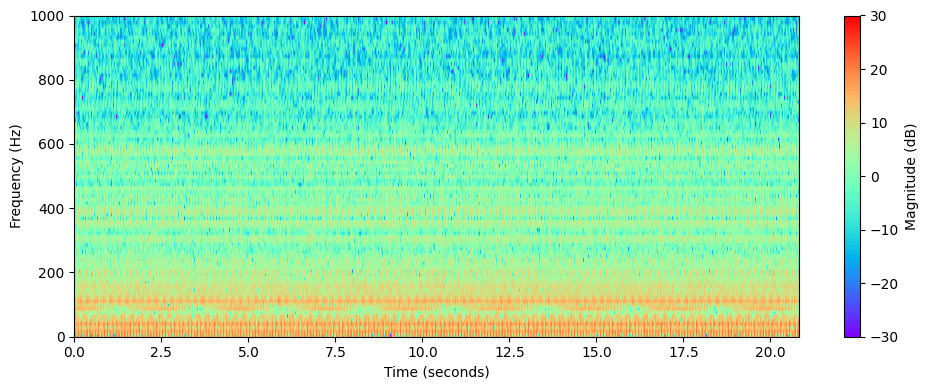

In [15]:
list_of_data_types = cage_fault_data

for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types

# Case-6: Outer race case

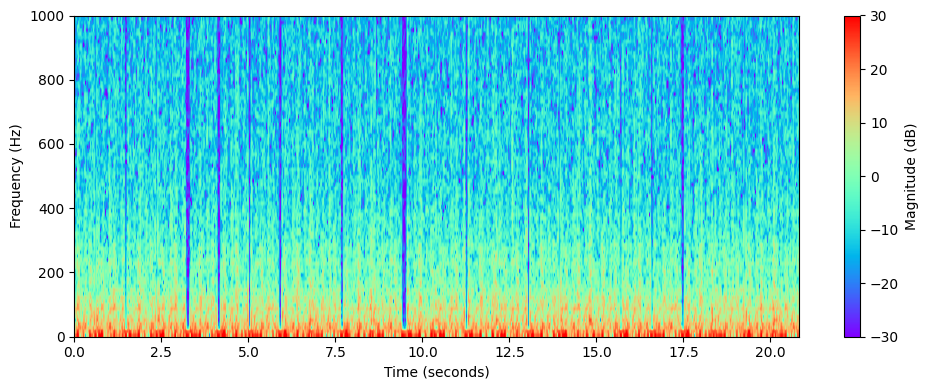

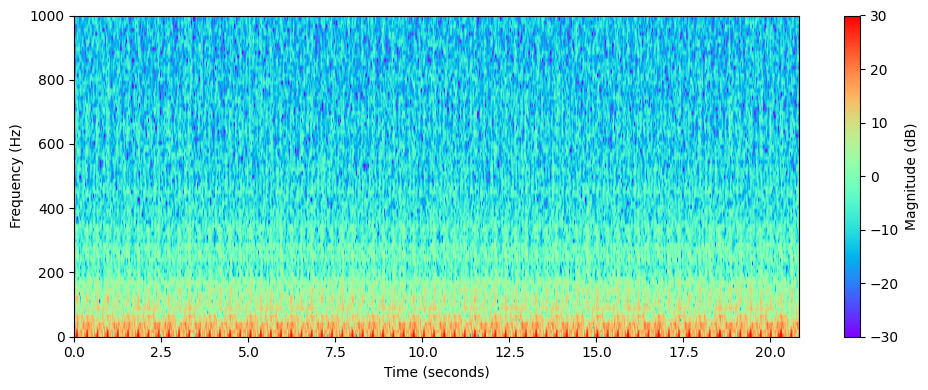

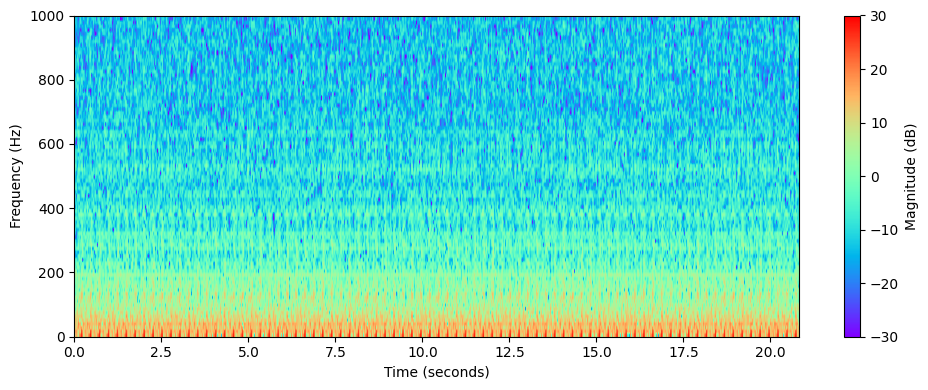

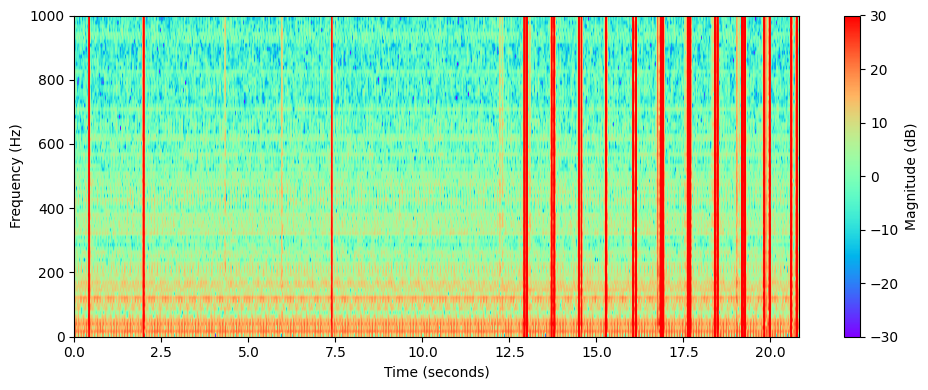

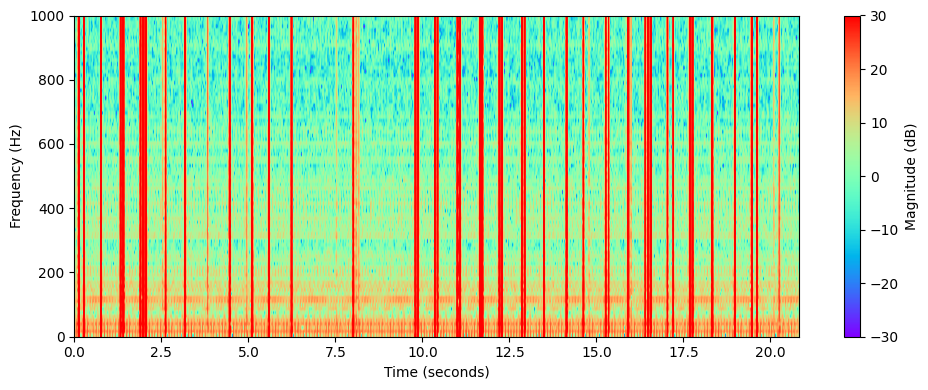

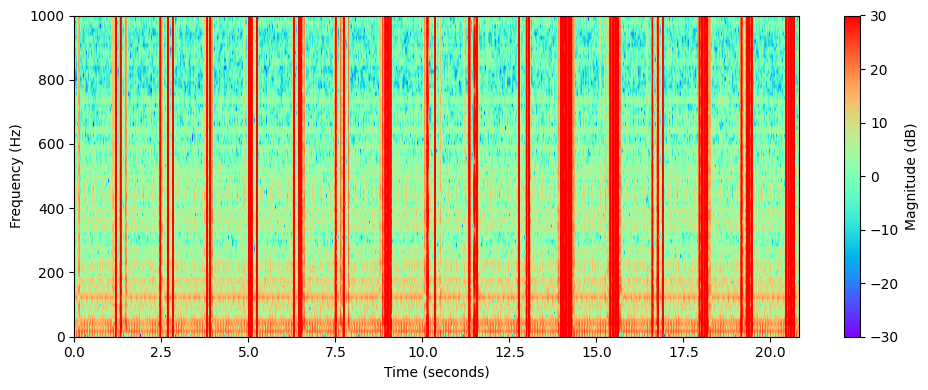

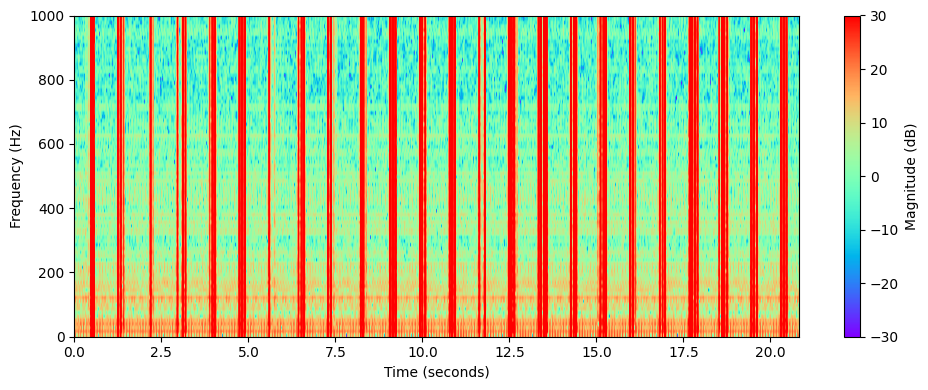

In [16]:
list_of_data_types = imbalance_data

for i in range(len(list_of_data_types)):

    # print(f"input data shape", list_of_data_types[i].shape)
    sig = list_of_data_types[i]
    sig = np.reshape(sig, (sig.shape[1], sig.shape[0]))
    # print(f"After reshape input data shape", sig.shape)

    samples = sig.shape[0]
    w_len = 1024
    overlapFac = 0.25
    Fs = 12000

    for l in range(samples):
        Y, T_coef, F_coef = stft_on_1s_window(sig[l], w_len, sr=Fs, overlapFac=overlapFac)

        # Plot spectrogram
        if l <= 3:
        #    print("Shape of spectrogram", Y.shape)
           fig = plt.figure(figsize=(10, 4))
           eps = np.finfo(float).eps
           plt.imshow(10 * np.log10(eps + Y), origin='lower', aspect='auto', cmap='rainbow',
                      extent=[T_coef[0], T_coef[-1], F_coef[0], F_coef[-1]])
           plt.clim([-30, 30])
           plt.ylim([0, 1000])
           plt.xlabel('Time (seconds)')
           plt.ylabel('Frequency (Hz)')
           cbar = plt.colorbar()
           cbar.set_label('Magnitude (dB)')
           plt.tight_layout()

        # sxx = 10 * np.log10(eps + Y)
        # image_shape = (32, 32)
        # sxx = resize(sxx, image_shape, mode='constant', anti_aliasing=True)


del list_of_data_types